In [1]:
import torch
from torchvision.models import resnet18
from ignite.utils import manual_seed
import pickle

from analyze import *

manual_seed(123)

sample batch


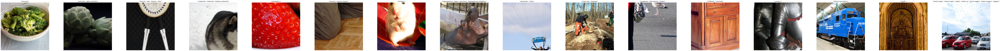

feature map before layer1: torch.Size([16, 64, 112, 112])
feature map between layer1 and layer2: torch.Size([16, 64, 56, 56])


In [2]:
with open('materials/samples/sample_ImageNet', 'rb') as f:
    sample = pickle.load(f)

print(f'sample batch')
visualize_images(sample['batch']['images'],
                 sample['batch']['tags'],
                 sample['batch']['used_normalization'],
                 sample['batch']['classes'])

model = resnet18(pretrained=True)

def prepare_testee_samples(model, batch):
    testee_samples = {}
    
    def extract_feature_map(location):
        def hook(m, i, o):
            testee_samples[location] = o.detach()
        return hook
    
    handle1 = model.relu.register_forward_hook(extract_feature_map('before_layer1'))
    handle2 = model.layer1.register_forward_hook(extract_feature_map('between_layer1_and_layer2'))
    
    model(batch)
    
    handle1.remove()
    handle2.remove()
    
    return testee_samples
    
feature_maps = prepare_testee_samples(model, sample['batch']['images'])

print(f'feature map before layer1: {feature_maps["before_layer1"].size()}')
print(f'feature map between layer1 and layer2: {feature_maps["between_layer1_and_layer2"].size()}')

In [46]:
def forward_issue05(x: torch.Tensor, threshold: int = 0.5, visualize: bool = False):
    b, c = 0, 61
    
    print(f'x[{b}][{c}]: {x[b][c]}')
    print(f'x shape: {x.shape}')
    print()
    
    mean = torch.mean(x, dim=[2, 3])
    print(f'mean: {mean}')
    print(f'mean shape: {mean.shape}')
    print()
    
    mask = torch.ge(mean, threshold)
    print(f'mask: {mask}')
    print(f'mask shape: {mask.shape}')
    print()
    
    mask_broadcastable_to_x = mask.unsqueeze(2).unsqueeze(3)
    print(f'mask_broadcastable_to_x[{b}][{c}]: {mask_broadcastable_to_x[b][c]}')
    print(f'mask_braodcastable_to_x shape: {mask_broadcastable_to_x.shape}')
    print()
    
    x_masked = x.masked_fill(~mask_broadcastable_to_x, 0)
    print(f'x_masked[{b}][{c}]: {x_masked[b][c]}')
    print(f'x_masked shape: {x_masked.shape}')
    print()
    
    if visualize:
        print(f'original x visualization')
        visualize_tensor(x)
        
        print(f'masked x by threshold: {threshold} visualization')
        visualize_tensor(x_masked)

x[0][61]: tensor([[0.7085, 0.7459, 0.7373,  ..., 0.8320, 0.8019, 0.7545],
        [0.8128, 0.8742, 0.8499,  ..., 0.9660, 0.9415, 0.8927],
        [0.8125, 0.8696, 0.8314,  ..., 0.9739, 0.9514, 0.9010],
        ...,
        [0.7412, 0.7940, 0.7643,  ..., 0.8757, 0.8822, 0.8473],
        [0.7474, 0.8091, 0.7762,  ..., 0.8714, 0.8857, 0.8491],
        [0.6956, 0.7437, 0.7284,  ..., 0.7910, 0.7964, 0.7525]])
x shape: torch.Size([16, 64, 112, 112])

mean: tensor([[0.2545, 0.2497, 0.0000,  ..., 0.6384, 0.0163, 0.2487],
        [0.2048, 0.3922, 0.0000,  ..., 0.3034, 0.1018, 0.3207],
        [0.2044, 0.3613, 0.0000,  ..., 0.3789, 0.0710, 0.3059],
        ...,
        [0.2706, 0.3019, 0.0000,  ..., 0.5595, 0.0180, 0.3050],
        [0.2277, 0.3167, 0.0000,  ..., 0.4459, 0.0663, 0.2780],
        [0.3045, 0.1854, 0.0000,  ..., 0.8243, 0.0121, 0.2041]])
mean shape: torch.Size([16, 64])

mask: tensor([[False, False, False,  ...,  True, False, False],
        [False, False, False,  ..., False, False,

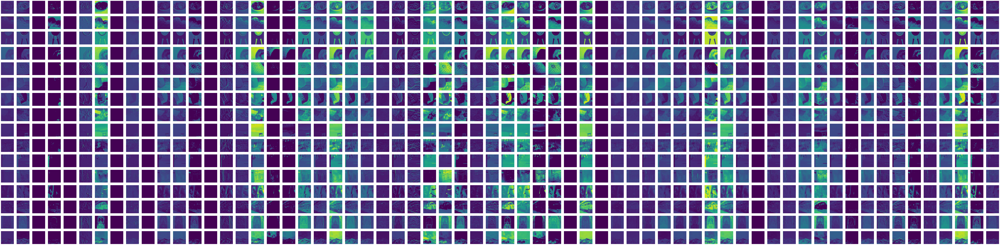

masked x by threshold: 0.5 visualization


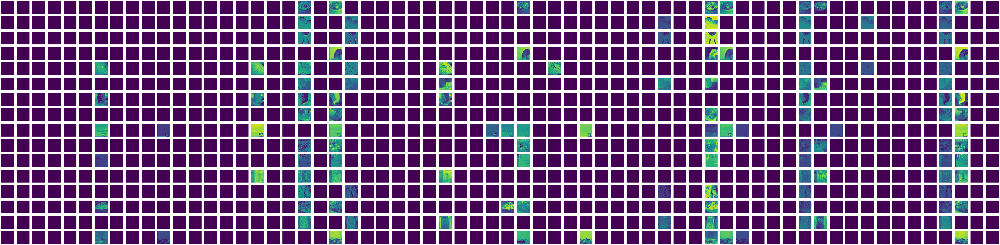

In [47]:
forward_issue05(feature_maps['before_layer1'], visualize=True)